Homework 4 — (15 points)
======
### What to hand in
You are to submit the following things for this homework:
1. A Jupyter notebook containing all code and output (figures and audio). I should be able to evaluate the file to reproduce all output. 
1. Any other data that we tell you to save to a file (e.g. audio files).

Note: Make sure to include all the files that are required for the notebook to run **from the submission folder** (e.g. police_noisy.wav). Points will be taken off from submissions that crash because Python cannot find the specified files.

### How to hand it in
To submit your lab:
1. Compress all of the files specified into a .zip file. 
1. Name the file in the following manner, firstname_lastname_hw1.zip. For example, Bryan_Pardo_hw1.zip. 
1. Submit this .zip file via Canvas

### Run this code block 1st, to import the needed packages

In [1]:
# This line is a convenience to import most packages you'll need. You may need to import others (eg random and cmath)
import IPython, numpy as np, scipy as sp, matplotlib.pyplot as plt, matplotlib, sklearn, librosa, cmath, math, nussl
from IPython.display import Audio
 
# This line makes sure your plots happen IN the webpage you're building, instead of in separate windows.
%matplotlib inline

### Some useful code

####  STFT 

In [2]:
from scipy.fftpack import fft
from scipy.signal import hann

def stft(signal, window_size, hop_size, window_type = 'hann'):
    """
    Computes the short term fourier transform of a 1-D numpy array, where the array 
    is windowed into a set of subarrays, each of length window_size. The distance between
    window centers (in samples) is given by hop_size. The type of window applied is
    determined by window_type. This returns a 2-D numpy array where the ith column
    is the FFT of the ith window. Each column contains an array of complex values.
    
    Input Parameters
    ----------------
    signal: The 1-d (complex or real) numpy array containing the signal
    window_size: an integer scalar specifying the number of samples in a window
    hop_size: an integer specifying the number of samples between the start of adjacent windows
    window_type: a string specifying one of two "hann" or "rectangular"
    
    Returns
    -------
    a 2D numpy array of complex numbers where the array column is the FFT of the ith window,
    and the jth element in the ith column is the jth frequency of analysis.
    """
    
    # figure out how many hops
    length_to_cover_with_hops = len(signal) - window_size;
    assert (length_to_cover_with_hops >= 0), "window_size cannot be longer than the signal to be windowed"
    num_hops = 1 + length_to_cover_with_hops/hop_size;
    
    # make our window function
    if (window_type == 'hann'):
        window = sp.signal.hann(window_size, sym=False)
    else:
        window = np.ones(window_size)
    
    stft = [0]*num_hops
    # fill the array with values 
    for hop in range(num_hops):
        start = hop*hop_size
        end = start + window_size
        unwindowed_sound = signal[start:end]
        windowed_sound =  unwindowed_sound * window
        stft[hop]= fft(windowed_sound, window_size) 
    return np.array(stft).T

#### ISTFT

In [3]:
from scipy.fftpack import ifft

def istft(X, hop_size):
    """
    Takes a 2-D numpy array representing an STFT of some signal, where stft[i,j] is the jth
    frequency of analysis in the FFT of the ith window. 
    Performs an inverse FFT on each window and then does overlap & add resynthesis to rebuild 
    the original signal the STFT was built from.
    
    Input Parameters
    ----------------
    X: a 2-D numpy array of complex numbers representing an STFT, where the ith 
    column is the FFT of the ith window, and the jth row is the jth frequency of analysis.
        
    hop_size: an integer specifying the number of samples between the start of adjacent windows.
        
    Returns
    -------
    a 1-d numpy array of (possibly complex) values representing the original signal used to make X
    """
    
    # make an empty signal of the appropriate length
    window_size,num_hops = X.shape
    signal_length = (num_hops-1)*hop_size + window_size 
    signal = np.zeros(signal_length,dtype='complex');
    
    #fill the signal
    for n in range(num_hops):
        start = n * hop_size
        end = start + window_size
        signal[start:end] = signal[start:end] + ifft(X[:,n])
    return signal

#### Spectrogram (plotting function with zooming options)

In [4]:
def plt_spectrogram(X,win_length, hop_size, sample_rate, zoom_x=None, zoom_y=None,tick_labels='time-freq'):
    """
    Plots the log magnitude spectrogram.
    
    Input Parameters:
    ------------------
    X: 2D complex numpy array containing the stft values. Rows correspond to frequency bins and columns to time frames.
    win_length: the length of the analysis window
    hop_size: the hop size between adjacent windows
    sample_rate: sampling frequency
    tick_labels: the type of x and y tick labels, there are two options:
                 'time-freq': shows times (sec) on the x-axis and frequency (Hz) on the y-axis (default)
                 'bin-frame': shows time frame numbers on the x-axis and frequency bin numbers on the y-axis
                
    zoom_x: 1 by 2 numpy array containing the range of values on the x-axis, e.g. zoom_t=np.array([x_start,x_end])
    zoom_y: 1 by 2 numpy array containing the range of values on the y-axis, e.g. zoom_f=np.array([y_start,y_end])
    
    
    Returns:
    ---------
    times: 1D real numpy array containing time instances corresponding to stft frames
    freqs: 1D real numpy array containing frequencies of analyasis up to Nyquist rate
    2D plot of the magnitude spectrogram
    """
    
    # Find the size of stft
    Nf,Nt=np.shape(X)
    
    # Compute the log magnitude spectrogram
    X=20*np.log10(np.abs(X))
    
    # Extract the first half of the spectrum for each time frame
    X=X[0:Nf/2]
    
    # Now that we've removed frequencies above Nyquist, keep track of the new number of frequencies
    Nf=np.shape(X)[0]
        
    # Generate a vector of values, showing the time of the middle of each window (used for plotting)
    times=(hop_size/float(sample_rate))*np.arange(Nt)
    
    # Generate a vector containing the set of fequencies of analysis of our FFT for plotting
    freqs=(float(sample_rate)/win_length)*np.arange(Nf)
    
    # Generate time and frequency matrices for pcolormesh
    times_matrix,freqs_matrix=np.meshgrid(times,freqs)
    
    # Plot the log magnitude spectrogram
    plt.title('Log magnitude spectrogram')
    if tick_labels == 'bin-frame':
        plt.pcolormesh(X)
        plt.xlabel('Time-frame Number')
        plt.ylabel('Frequency-bin Number')
    else:
        plt.pcolormesh(times_matrix,freqs_matrix,X)
        plt.xlabel('Time (sec)')
        plt.ylabel('Frequency (Hz)')

        
    # Zoom in on the plot if specified
    if zoom_x is None and zoom_y is None:
        plt.axis('tight')
        
    if zoom_x is not None:
        plt.xlim(zoom_x)
        
    if zoom_y is not None:
        plt.ylim(zoom_y)
        
    return    

### Time-Frequency Masking

#### 1. (0.5 points) Load *police_noisy.wav*. The audio contains a ringing noise somewhere. Calculate the STFT of the audio signal and the magnitude spectrogram respectively denoted by *X* and *V*, using a hann window of length 2048 and 50% overlap between adjacent windows. Keep in mind that the magnitude spectrogram includes only the first half of the spectrum for each time frame. Use the function *plt_spectrogram* provided above to plot the *log magnitude spectrogram* of the audio signal. Identify the region of the ringing noise. It should be a square of about 30 frequency bins by 30 time frames. Write down the frequency and time indices in your report. 

#### * Note: we need to find the coordinates of the noisy region in terms of frequency bin number and time frame number, not in Hz and seconds. You can use the tick_labels parameter to set the values on the x-axis and y-axis to the required units. Moreover, zoom-x and zoom-y parameters can be set to narrower ranges in order to give better estimates of the region boundaries. Be careful about the consistency of zoom-x and zoom-y units with tick-labels.*

The region of the ringing noise is located from time frames 385-412 and frequency bins 385-415.

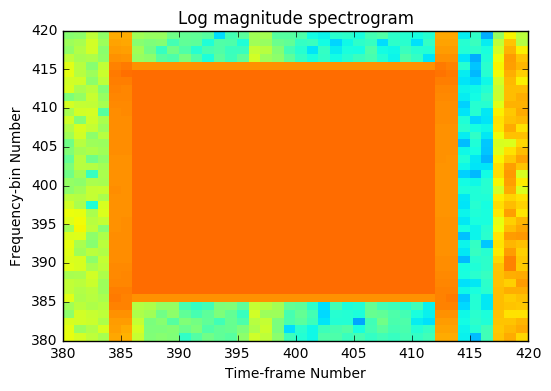

In [5]:
#define sample rate, window size, hop size
sr = 44100.
ws = 2048
hs = 1024

#these are the coordinates I've zoomed into
x_start = 380
x_end = 420
y_start = 380
y_end = 420
zoom_t = np.array([x_start, x_end])
zoom_f = np.array([y_start, y_end])

#load file, compute stft
police_noisy, sr = librosa.load('police_noisy.wav', sr)
X = stft(police_noisy, window_size=ws, hop_size=hs)

#get log magnitude spectrogram
Nf,Nt=np.shape(X)
V=20*np.log10(np.abs(X))
V=V[0:Nf/2]

#zoom into the noisy spot to get the location
plt_spectrogram(X, win_length=ws, hop_size=hs, sample_rate=sr, tick_labels='bin-frame', zoom_x=zoom_t, zoom_y=zoom_f)

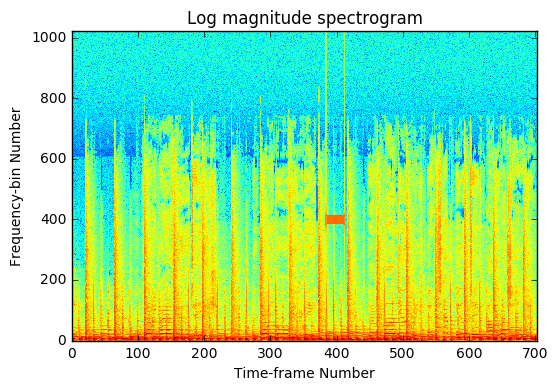

In [6]:
#plot whole spetrogram for reference and listen to signal
plt_spectrogram(X, win_length=ws, hop_size=hs, sample_rate=sr, tick_labels='bin-frame')
Audio(police_noisy, rate=sr)

#### 2. (0.5 points) Use the frequency and time indices you found in Question 1 to create a simple binary time-frequency mask to remove the region of the ringing noise. The binary mask, *M*, should be of the same size as the magnitude spectrogram *V* (covering only half of the STFT output). Derive a full (two-sided) time-frequency mask, *M_full*, from *M* and apply it to the STFT of the noisy audio. Compute the denoised signal by tranforming the masked STFT, *X_masked*, back to the time domain. Plot the magnitude spectrogram of the denoised audio and check that the region of the ringing noise has been removed. 



/home/mattniemer/miniconda2/envs/eecs352/lib/python2.7/site-packages/IPython/lib/display.py:123: ComplexWarning: Casting complex values to real discards the imaginary part
  data = np.array(data, dtype=float)


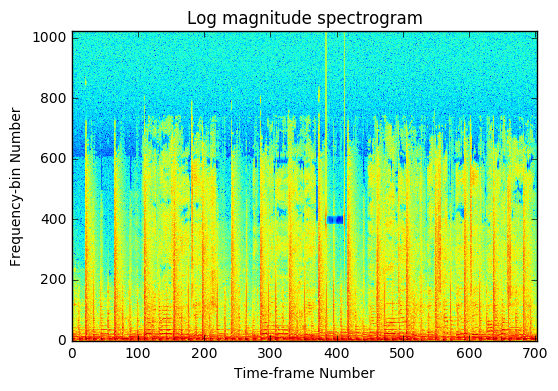

In [7]:
#create mask
M = np.ones(V.shape)
M[385:415, 385:412] = 0.0000000000000000000000001

#create two sided mask
M_full = np.concatenate((M, np.flipud(M)))

#apply mask and plot spectrogram
X_masked = X * M_full

#listen to the denoised signal and plot spectrogram
police_denoised = istft(X_masked, hs)
denoised_stft = stft(police_denoised, window_size=ws, hop_size=hs)
plt_spectrogram(denoised_stft, win_length=ws, hop_size=hs, sample_rate=sr, tick_labels='bin-frame')
Audio(police_denoised, rate=sr)
#noise is gone yay!

#### 3. (0.5 points) Explain why the time-frequecy mask cannot be applied to the magnitude spectrogram to extract the noise. Why do we need to derive a *full* time-frequency mask to make a version of police_noisy.wav that doesn't have the ringing? 

We need to derive a full time-frequency mask in order to extract the noise because we can't invert a spectrogram. A spectrogram only contains the frequencies from 0 to half the Nyquist rate - in order to convert back into the time domain, we need the whole set of frequencies, including the values which are reflected over the Nyquist/2 line. Thus, when we create our binary mask from the spectrogram, we need to reflect our mask over the Nyquist/2 line and then apply the mask to the STFT. Once we have done that, we can take the ISTFT and analyze the signal in the time domain.

### Beat Spectrum

#### 4. (1 point) We have provided an implementation of the autocorrelation function. Note that we normalize by the number of nonzero additions. Explain the effect this has (compared to the standard autocorrelation in numpy) and tell us why you think we did this.  Hint: What are we using the autocorreation function for in REPET? How does normalizing affect that?

The numpy autocorrelation function doesn't normalize by the number of nonzero additions - this means that the function will always have the greatest autocorrelation when the offset is 0, and the autocorrelation will generally decrease as the number of nonzero additions increases. This matters a lot for the task that we are trying to accomplish with REPET. REPET uses the autocorrelation function to identify repeating segments in a piece of music - a repeating signal will be have a high autocorrelation at places where the pattern repeats, but if we don't normalize the high autocorrelation at that point won't stand out against its neighbors because the function generally decreases with increased padding. Normalizing the autocorrelation function ensures that we see these peaks clearly where a signal has a repeating segment.

In [8]:
def acorr(x):
    """
    Takes a 1D numpy array and returns the autocorrelation. 
    
    Input Parameter:
    ----------------
    x: 1D numpy array of length Lx
    
    Ouput Parameter:
    ----------------
    x_acorr: 1D numpy array of length x_len containing the values of the autocorrelation function of x
    
    Note: the actual length of autocorrelation function is (2*x_len)-1, but since this function is symmetric
          we can cut off (x_len)-1 samples and return one side of length x_len without losing information. 
    """
    
    x_len=np.size(x)
    x_pad=np.concatenate([x,np.zeros(x_len-1)])
    x_acorr=ifft(np.abs(fft(x_pad))**2).real
    x_acorr=x_acorr[0:x_len]
    
    x_acorr=x_acorr/(np.arange(x_len)[::-1]+1)  # normalize by the number of nonzero additions
            
    return x_acorr

# Test case: 
# Note: the numpy correlate function is not normalized so the results seem different. If you comment out the 
#       normalization line above the outputs will be the same.
test_array=np.arange(10)
print 'Output of the accor function:  '+ str(acorr(test_array))
print 'Output of the correlate function:  '+str(np.correlate(test_array,test_array,"full")[len(test_array)-1:2*len(test_array)])


Output of the accor function:  [  2.85000000e+01   2.66666667e+01   2.45000000e+01   2.20000000e+01
   1.91666667e+01   1.60000000e+01   1.25000000e+01   8.66666667e+00
   4.50000000e+00   7.38824206e-14]
Output of the correlate function:  [285 240 196 154 115  80  50  26   9   0]


#### 5. (1 points) Implement the beat spectrum. Use the autocorrelation function from Question 4. Do not square the magnitude spectrogram within your function; it will be squared outside the function, in the *repet* function. 

In [9]:
def beat_spectrum(S):
    """
    Computes the beat spectrum of a music mixture by applyting the autocorrelation to all frequency channels (rows)
    of the spectrogram and taking the average. Note that the assumption is that the mixture is composed of a repeating
    background and a non-repeating foreground. Therefore, the spikes in the beat spectrum represent the repetitive 
    events in the spectrogram.  This function must PLOT the beat spectrum for viewing, since you'll be looking at the
    resulting plot to pick the repeating period used by REPET. 
    
    Input Parameter:
    ----------------
    S: 2D numpy array containing the spectrogram of a signal
    
    Output Parameter:
    ------------------
    beat_spec: 1D numpy array containing the beat spectrum 
    
    """
    auto_corr = np.zeros(S.shape)
    for i in range(S.shape[0]):
        auto_corr[i] = acorr(S[i,:]) #autocorrelate with frequency channels

    beat_spectrum = np.average(auto_corr, axis=0)
    plt.plot(beat_spectrum)
    plt.title('Beat Spectrum')
    plt.xlabel('Lag (samples)')
    plt.show()
    
    return beat_spectrum
    

#### 6. (1 point) Apply the function to the spectrogram of the noisy (*police_noisy.wav*) as well as the denoised signals (the same signal after you removed the ringing). Plot both beat spectra. Do you observe any noticeable difference between the plots? What information does the beat spectrum provide regarding the ringing noise?

I can't tell much a difference between either beat spectrum. They seem to be pretty much the same. Thus, the beat spectrum really doesn't provide any information at all regarding the ringing noise - it's blind to a small change in the signal (which is what we want and expect).

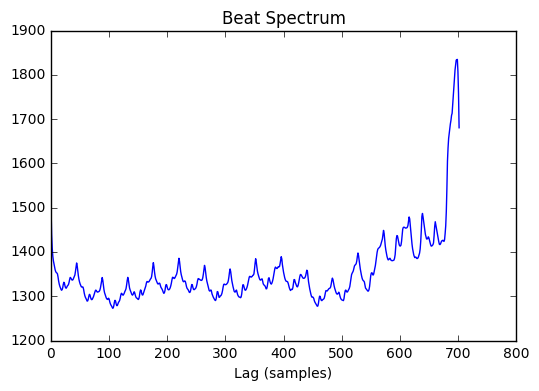

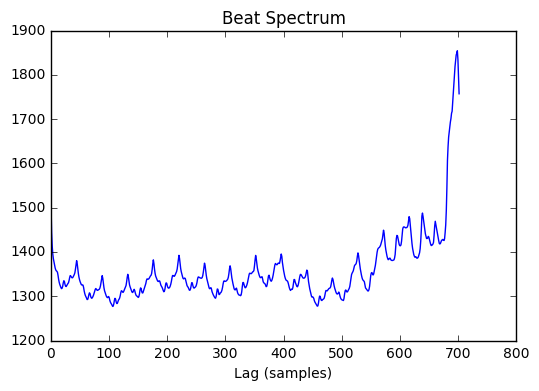

In [10]:
#we already have the noisy_police spectrogram in varible V
noisy_spect = V

#get the denoised spectrogram
Nf,Nt = np.shape(denoised_stft)
denoised_spect = 20*np.log10(np.abs(denoised_stft))
denoised_spect = denoised_spect[0:Nf/2]

#run it on both
B = beat_spectrum(noisy_spect)
B = beat_spectrum(denoised_spect)

#### 7. (0.5 points) Explain how you would find the period of the repeating structure from the beat spectrum. Remember that the repeating period does not necessarily correspond to the first highest peak. Remember also that the beat spectrum goes from lag 0 to lag n-1, where n is the length of the input signal.

There's a couple of different methods. REPET employs the use of a picking algorithm which searches the beat specturm for the best possible period. It's also possible to eyeball the beat spectrum and identify a series of peaks which are evenly spaced and have about the same height. In general, this will indicate that the repeating period exists with a length that is the same as the separation between the selected beat spectrum peaks.

### REPET Algorithm

#### 8. (2 point) Implement a repeating-segment modeling function (Hint: use the numpy *median* function). Note that after segmentation of the spectrogram, the last segment is generally shorter (in time frames) than the other segments, because the number of time frames is not necessarily an integer multiple of the repeating period; Think about how you would handle that.

In [11]:
def repeating_segment(V,p):
    """
    Computes the repeating-segment model using the period obtained from the beat spectrum. 
    The repeating segment is that median background we'll be using to compare to the spectrum. 
    Its time duration will be the length of one period that you learned from the beat spectrum. 
    
    Input Parameters:
    -----------------
    V: 2D numpy array containing the magnitude spectrogram of the mixture
    p: scalar, repeating period (in number of samples) found from the beat spectrum 
    
    Output Parameter:
    S: 2D numpy array containing the repeating segment 
    """  
    #initialize
    num_segments = V.shape[1]/p
    segments = np.zeros((num_segments, p, V.shape[0]))
    
    #split up the spectrogram into segments
    for i in range(num_segments-1):
        start = i*p
        segments[i] = V[:, start:start+p].T
    
    #just drop the last one. It won't affect our median that much.
    
    #take the median
    S = np.median(segments, axis=0)
    return S

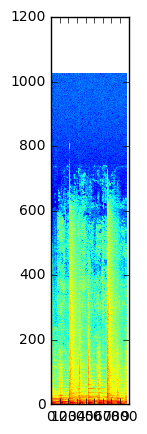

In [12]:
#do a quick test to make sure this is what we expect
#eyeball the period to be about 88 samples
period = 88
S = repeating_segment(denoised_spect, period)
plt.figure(figsize=(1,5)) #squish it to see if it's roughly what we would expect
plt.pcolormesh(S.T)

#### 9. (1 point) Implement a repeating spectrogram modeling function (Hint: use the min function). Again, the last segment in your spectrogram is generally shorter than the repeating segment model. 

In [13]:
def repeating_spectrogram(V,S):
    """
    Builds the repeating-spectrogram model using the repeating segment model computed in the 
    previous question. This is composed of multiple copies of the repeating segment, tiled 
    together in the time-dimension so that it is the exact same size as the input signal's 
    spectrogram.
    
    Input Parameters:
    -----------------
    V: 2D numpy array containing the magnitude spectrogram of the mixture
    S: 2D numpy array containing the repeating segment model 
    
    Output Parameter:
    ------------------
    W: 2D numpy array containing the repeating-spectrogram 
    """
    #initialize
    W = np.zeros(V.shape)
    p = S.shape[0]
    num_segments = V.shape[1]/p
    
    #take the min and tile together for all but the last segment
    for i in range(num_segments):
        start = i*p
        W[:, start:start+p] = np.minimum(V[:, start:start+p], S.T)
    
    #add the last one
    last_len = W.shape[1] - num_segments*p
    W[:, num_segments*p:] = np.minimum(V[:, num_segments*p:], S[:last_len].T)
    return W

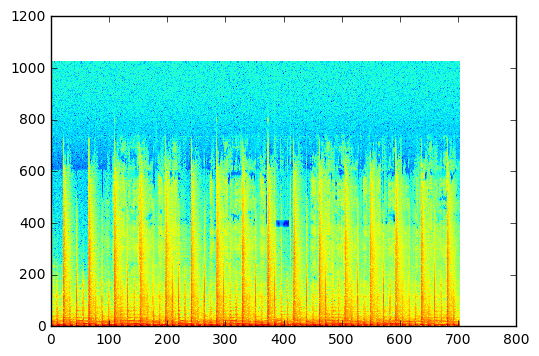

In [14]:
#do a quick test to make sure this is what I expect...
W = repeating_spectrogram(denoised_spect, S)
plt.pcolormesh(W)

#### 10. (1 point) Implement a repeating-mask modeling function (Hint: use a division). Note that there could be zero values in your spectrogram. Think about how to handle that. 

In [15]:
def repeating_mask(V,W):
    """
    Before we do our separation, we need to compare our repeating_spectrogram to the original spectrogram of the signal
    to determine how to assign the energy in each time-frequency point (each element in your matrix). This function
    does that and makes a mask that will be applied to the spectrum. Note that unlike the denoising case in the first 
    question, here we are computing a "soft mask" with values ranging between 0 and 1.
    
    Input Parameters:
    -----------------
    V: numpy 2D array containing the magnitude spectrogram 
    W: numpy 2D array containing the repeating spectrogram
    
    Output Parameter:
    M: numpy 2D array containing the repeating mask 
    """
    M = (W + 0.000000000000000001) / (V + 0.00000000000000001) #add so we don't divide by 0
    return M
    #we'll test this by just running REPET

### Music-voice Separation

#### 11.  (2 points) The function provided below runs the REPET algorithm using functions you wrote in previous questions. REPET builds a soft time-frequency mask (with values between 0 and 1), but we can also derive a binary time-frequency mask from it (with values of only 0s and 1s). To do so, we simply use a threshold value between 0 and 1 in the soft mask, so that values above the threshold will be forced to 1, while values below the threshold will be forced to 0. A binary mask can help to improve the perception of separation, but it will also increase the separation artifacts. 

#### Select the value of the repeating period in samples and the value of the masking threshold. Try different values of the masking threshold and compute the background and foreground audio estimates. Listen to the estimate and plot the magnitude spectrograms of the background and foreground estimates for each masking threshold you try. Write down the value of the masking threshold that gave you the best separation results.

#### Describe the separation results that you have obtained. Are the repeating musical background and the non-repeating vocal foreground well separated? Did you get any kind of audio artifacts? What did happen to the ringing noise? Why? 

In [16]:
def repet(file_path, rep_period, mask_thr, sample_rate=44100):
    """
    Runs the REPET algorithm using functions implemented in qustions 3 through 8. NOTE: In the real REPET algorithm
    it also determines the repeating period from the beat spectrum by building a peak picker to find the best
    period from the beat spectrum. This seemed like too much for a homework, so we're making YOU the peak picker. 
    You'll have to run the beat_spectrum function before calling repet and input the value for rep_period.
    
    Input Parameters:
    ------------------
    file_path: string, path to the audio file to separate
    rep_period: scalar, repeating period in number of samples
    mask_thr: scalar, a value between 0 and 1 for thresholding the soft mask
    
    Plots:
    --------
    Separated background and foreground magnitude spectrogram plots 
    
    Returns: 
    ---------
    Separated background and foreground time signals
    """
    
    # Load the noisy mixture
    signal, sample_rate = librosa.load(file_path, sample_rate) 

    # Comput the stft of the audio signal 
    win_length_sec=0.04 # 40 msec window
    win_length_samp=int(2**np.ceil(np.log2(win_length_sec*sample_rate))) # next power2 of winow length in no. of samples
    n_fft=win_length_samp
    hop_size=win_length_samp/2 # 50% overlap
    win_type=sp.signal.hanning
    X = stft(signal, win_length_samp, hop_size, window_type = 'hann')

    # Compute the magnitude spectrogram (half spectrum)
    Vm = np.abs(X[0:win_length_samp/2+1,:])
    Nf,Nt=Vm.shape
    
    
    # Compute and plot the beat spectrum
    beat_spec = beat_spectrum(Vm**2)
    beat_spec = beat_spec/beat_spec[0] # normalization
    
    plt.figure()
    plt.plot(beat_spec)
    plt.grid('on')
    plt.axis('tight')
    plt.xlabel('Lag (sample number)')
    plt.title('Beat spectrum of the noisy mixture')
    
    ### REPET Algorithm ###
    
    # Compute the repeating soft mask
    Sm=repeating_segment(Vm,rep_period)
    Wm=repeating_spectrogram(Vm,Sm)
    soft_mask=repeating_mask(Vm,Wm)
        
    # Compute the repeating binary mask
    binary_mask=np.zeros(soft_mask.shape)
    binary_mask[soft_mask>=mask_thr]=1
    
    
    # Estimate the background and foreground via masking
    binary_mask=np.vstack([binary_mask,np.flipud(binary_mask[1:-1,:])])
    
    X_bg = binary_mask*X+1e-16  # background STFT
    signal_bg = np.real(istft(X_bg, hop_size)) # background time signal
    
    X_fg = (1-binary_mask)*X+1e-16  # foreground STFT
    signal_fg = np.real(istft(X_fg, hop_size)) # foreground time signal
            
    # Plot the log magnitude spectrograms and the binary mask
    plt.figure()    
    plt.subplot(211)
    plt_spectrogram(X,win_length_samp, hop_size, sample_rate,tick_labels='time-freq')
    plt.title('Mixture')
        
    plt.subplot(212)
    plt.pcolormesh(binary_mask[0:Nf,:])
    plt.xlabel('Time (sec)')
    plt.ylabel('Frequency (Hz)')
    plt.title('Binary mask')
    plt.axis('tight')
    
    plt.figure()
    plt.subplot(211)
    plt_spectrogram(X_bg,win_length_samp, hop_size, sample_rate,tick_labels='time-freq')
    plt.title('Background')
    
    plt.subplot(212)
    plt_spectrogram(X_fg,win_length_samp, hop_size, sample_rate,tick_labels='time-freq')
    plt.title('Foreground')
    
    return signal_bg,signal_fg

    

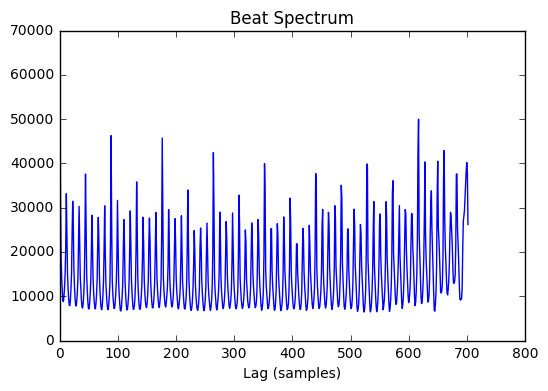

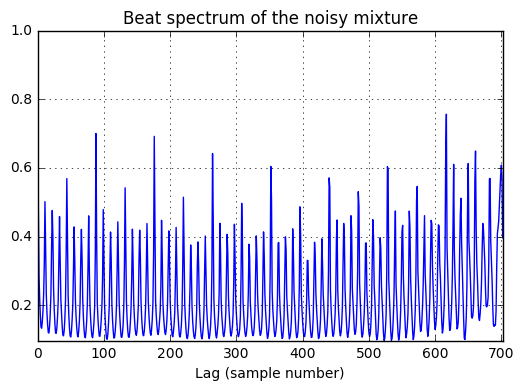

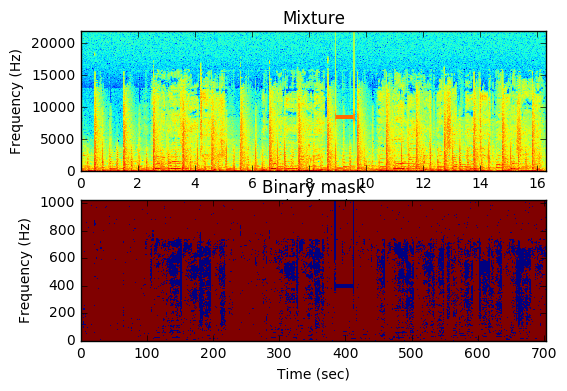

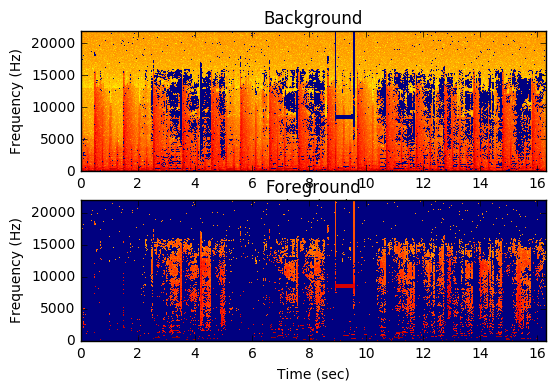

In [17]:
#note I added an optional sample_rate parameter because the question below asks us to sample at 22050...
#the repet function assumes a hard coded sample_rate of 44100, this will mess with the speed/length of the track
#adding the optional parameter fixes this

#closed in on 88 samples as a period after examining the beat spectrum closely, plus trial and error
#0.25 was also discovered as the best threshold after trial and error

#police_bg, police_fg = repet('police_noisy.wav', 88, .1, sample_rate=sr)
police_bg, police_fg = repet('police_noisy.wav', 88, .25, sample_rate=sr)
#police_bg, police_fg = repet('police_noisy.wav', 88, .5, sample_rate=sr)
#police_bg, police_fg = repet('police_noisy.wav', 88, .75, sample_rate=sr)
#police_bg, police_fg = repet('police_noisy.wav', 88, .9, sample_Rate=sr)

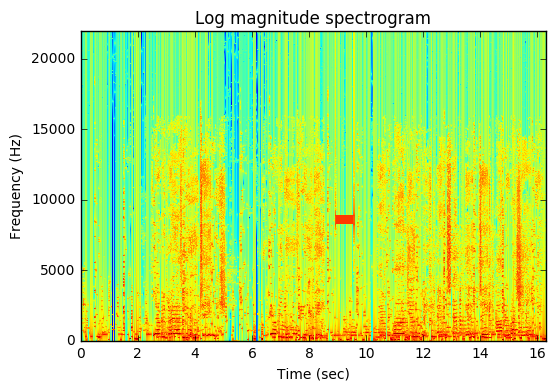

In [18]:
plt_spectrogram(stft(police_fg, ws, hs), ws, hs, sr)
Audio(police_fg, rate=sr) #just the vocals

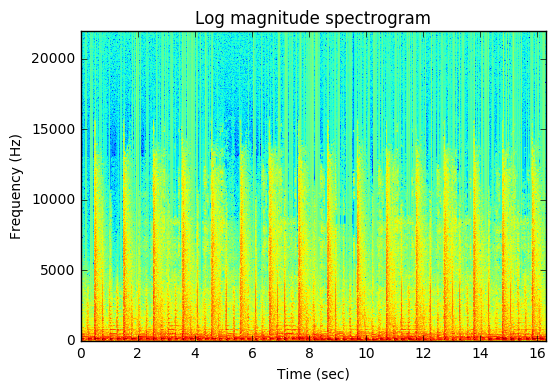

In [19]:
plt_spectrogram(stft(police_bg, ws, hs), ws, hs, sr)
Audio(police_bg, rate=sr) #just the background

A threshold of 0.25 worked best to appropriately separate the vocals from the background. The separation results are good! The repeating musical background and the non-repeating vocal foreground are well separated. There are a lot of artifacts, especially in the foreground - you can hear the beeping and bopping which is a little annoying. The background has less noise/artifacts, and pretty much sounds exactly as we would expect - there's just an echo of a voice. The ringing noise at about 8 seconds made its way into the vocal foreground. That's because it's not a repeating part of the track, so it doesn't get masked as part of the background.

### Source separation using NUSSL

NUSSL is an audio source separation python package developed by the [Interactive Audio Lab](http://music.eecs.northwestern.edu). In this part, you will use the NUSSL implementation of REPET and compare it to your implementation. You will also try an extended version of REPET, called REPET-SIM, and compare the performance of the two algorithms on an audio mixture of your choice. To install NUSSL, run the following command while your eecs352 environment is activated:
```
pip install nussl==0.1.5a10
```

More information on the installation and troubleshooting can be found [here](https://interactiveaudiolab.github.io/nussl/getting_started/install.html).


#### 12. (2 points) Go out on the web and find an example of music where REPET works well to separate out the voice and an example where it works poorly and do the following:
1. Crop each example to be between 10 and 30 seconds (pick a length appropriate for making your point)
1. Save each cropped example at the sample rate 22050 Hz
1. Make each example monophonic (i.e. one channel, not two)
1. Include both examples with your submission
1. Separate the sources using your implementation of REPET.  
1. Read the documentation on NUSSL implementation of REPET [here](https://interactiveaudiolab.github.io/nussl/src/repet.html), and use it to do source separation on the same mixture.
1. Compare the results of the previous two steps. For instance, play the separated sources or plot their log magnitude spectrograms. Do the results of the two implementations (yours and NUSSL's) match? 

The results from our version of REPET and the NUSSL implementation of REPET are very similar. Listening to all 4 singals, it's easy to pick out the patterns we expect. Our REPET and NUSSL's REPET both sound very similar on both signals. The say_it_aint_so signal is harder for both REPETs to separate, while the island_in_the_sun signal is fairly easy. The NUSSL REPET includes significantly less audio artifacts (the beep boops) in the foreground. It also tends to include more vocals in the background, which in turn makes the foreground vocals more clear.

In [20]:
sr = 22050
say_it_aint_so, sr = librosa.load('say_it_aint_so.wav', sr) 
#this one should be bad for REPET
#I cropped it right at the bridge
Audio(say_it_aint_so, rate=sr)

In [21]:
island_in_the_sun, sr = librosa.load('island_in_the_sun.wav', sr) 
#this one should be good with REPET
#it has a steady repeating drum
Audio(island_in_the_sun, rate=sr)

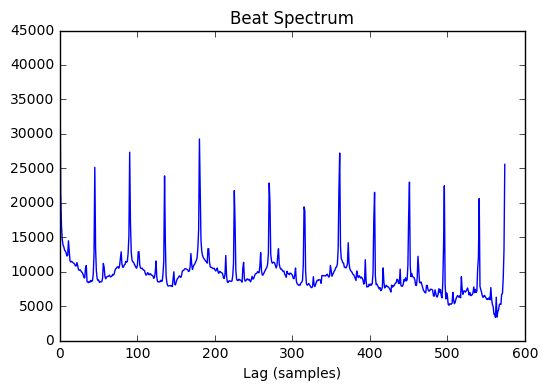

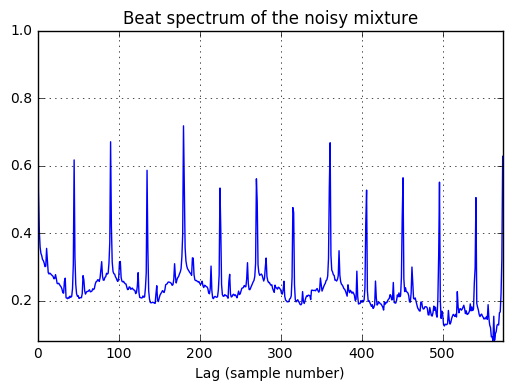

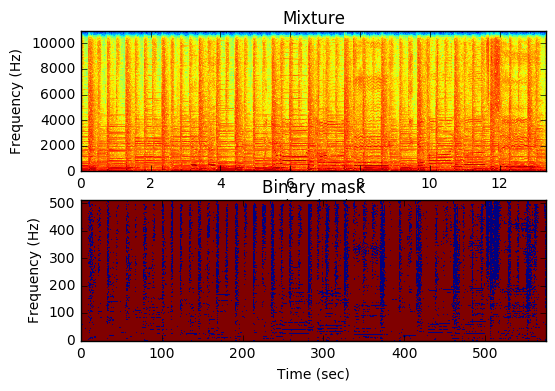

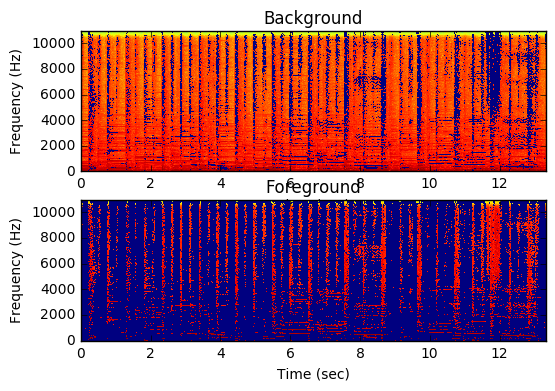

In [22]:
island_bg, island_fg = repet('island_in_the_sun.wav', 93, .25, sample_rate=sr)

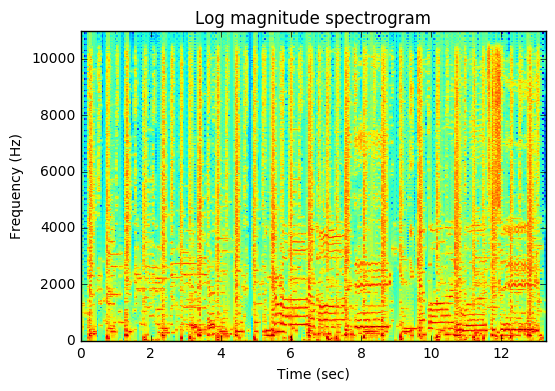

In [23]:
plt_spectrogram(stft(island_fg, ws, hs), ws, hs, sr)
Audio(island_fg, rate=sr) 
#great! this is pretty much just the vocals
#the drums are bleeding through though a little bit which is surprising

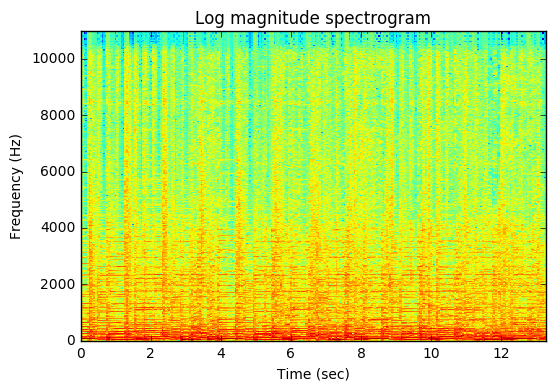

In [24]:
plt_spectrogram(stft(island_bg, ws, hs), ws, hs, sr)
Audio(island_bg, rate=sr) #and this is pretty much just the background guitars and drums

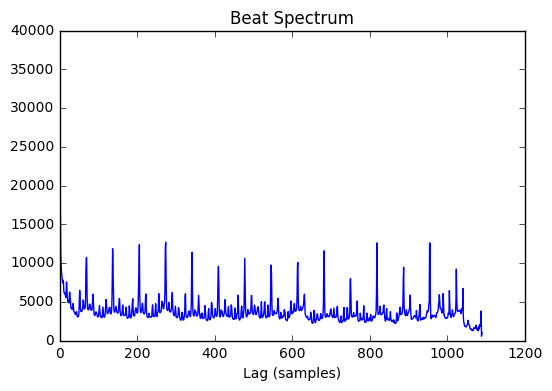

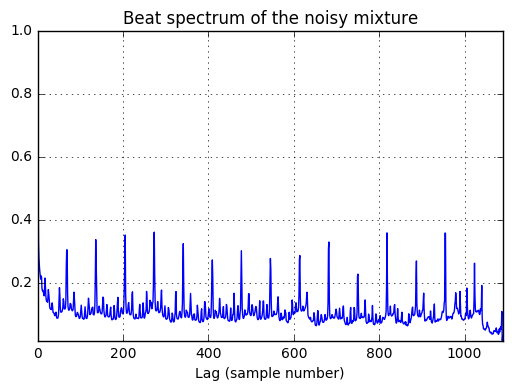

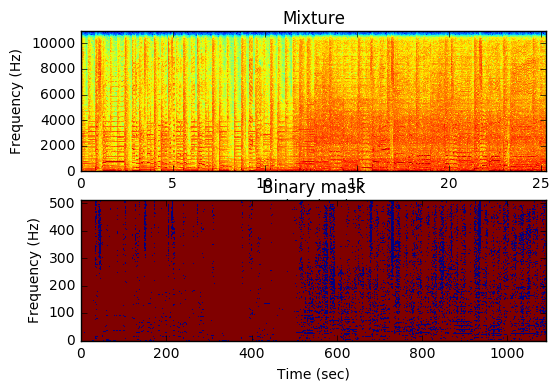

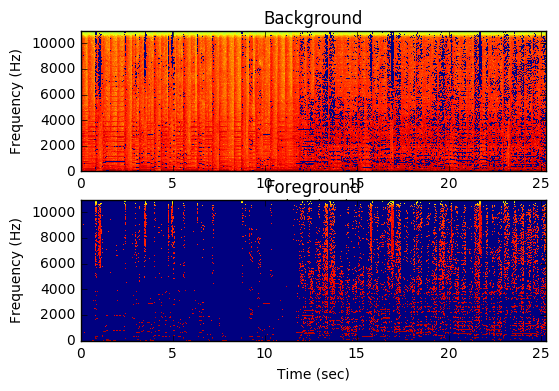

In [25]:
say_bg, say_fg = repet('say_it_aint_so.wav', 51, .25, sample_rate=sr)

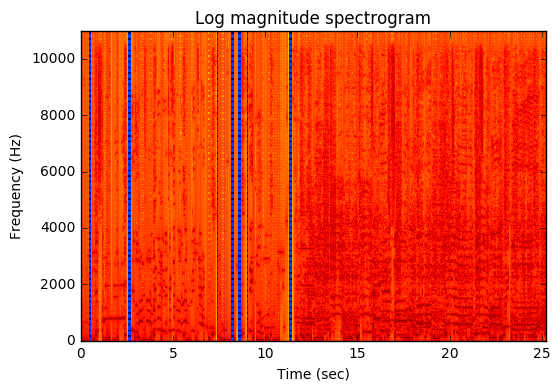

In [26]:
plt_spectrogram(stft(say_fg, ws, hs)+0.00000000000000000001, ws, hs, sr) #add to stft to avoid log10(0)
Audio(say_fg, rate=sr)
#this actually works better than I thought it would...
#basically it just picks up the guitars when it gets to the refrain. Still worse than the previous example
#spectrograms look pretty funky (as expected)

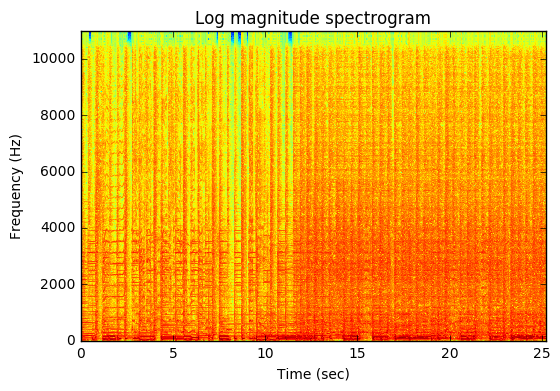

In [27]:
plt_spectrogram(stft(say_bg, ws, hs), ws, hs, sr)
Audio(say_bg, rate=sr)
#we can hear a lot of the vocals in the background signal
#plus these spectrograms look pretty funky

In [28]:
# Set up and run Repet with island_in_the_sun
island_nussl = nussl.AudioSignal(path_to_input_file='island_in_the_sun.wav')
repet = nussl.Repet(island_nussl)
repet.run()
island_bg_nussl, island_fg_nussl = repet.make_audio_signals()

#repeat process with say_it_aint_so
say_nussl = nussl.AudioSignal(path_to_input_file='say_it_aint_so.wav')
repet = nussl.Repet(say_nussl)
repet.run()
say_bg_nussl, say_fg_nussl = repet.make_audio_signals()

/home/mattniemer/miniconda2/envs/eecs352/lib/python2.7/site-packages/nussl/spectral_utils.py:218: UserWarning: n_fft_bins ignored. Librosa's stft uses window_length as n_fft_bins
  warnings.warn("n_fft_bins ignored. Librosa's stft uses window_length as n_fft_bins")


In [29]:
sr = 44100
#plotting the spectrogram does wierd things to my computer so I'm going to listen instead
Audio(island_bg_nussl.audio_data, rate=sr)
#result is pretty much the same, though the nussl version includes more vocals in the background

In [30]:
Audio(island_fg_nussl.audio_data, rate=sr)
#the vocals are very clear, however. Very little background noise

In [31]:
Audio(say_bg_nussl.audio_data, rate=sr)
#again, we can hear a lot of vocals in the background. This one is more similar to our version of repet

In [32]:
Audio(say_fg_nussl.audio_data, rate=sr)
#again, good vocals. But we get a lot of guitars in the second half (as in our version of repet)

#### 13. (1 point) Read the paper on REPET-SIM, which generalizes the approach used by REPET for audio source separation. The paper can be found [here](http://music.eecs.northwestern.edu/publications/Rafii-Pardo%20-%20Online%20REPET-SIM%20for%20Real-time%20Speech%20Enhancement%20-%20ICASSP%202013.pdf). Do you expect better or worse performance  on the audio you found for question 12, compared to REPET? Why? 

REPET-SIM uses similarity matrices instead of a beat spectrum to separate out the background signal. While REPET was designed specifically for music, REPET-SIM is better for separating voices from real-world background noise. Thus, when using REPET-SIM to separarate vocals and background in music probably won't be as good on my samples in question 12 as REPET.

#### 14. (1 point) Now, apply the NUSSL implementation of REPET-SIM to your selected mixture and compare the results to those of REPET.  Explain whether the new results confirm your hypothesis or reject it. 

The biggest difference between the NUSSL REPET and NUSSL's REPET-SIM is in the background. The background separated out using REPET-SIM is very scratchy and has lots of static. Ultimately, my hypothesis was confirmed. In general, the NUSSL implementation of REPET performs better on the music samples than REPET-SIM. The REPET-SIM separation is still surprisingly good, but REPET separates the samples pretty well into background and foreground signals while REPET-SIM just has more noise.

In [33]:
# Set up and run Repet with island_in_the_sun
island_nussl = nussl.AudioSignal(path_to_input_file='island_in_the_sun.wav')
repetsim = nussl.RepetSim(island_nussl)
repetsim.run()
island_bg_nussl, island_fg_nussl = repetsim.make_audio_signals()

#repeat process with say_it_aint_so
say_nussl = nussl.AudioSignal(path_to_input_file='say_it_aint_so.wav')
repetsim = nussl.RepetSim(say_nussl)
repetsim.run()
say_bg_nussl, say_fg_nussl = repetsim.make_audio_signals()

In [34]:
sr = 44100
Audio(island_bg_nussl.audio_data, rate=sr)
#yup I was right. This is definitely more noisy than NUSSL's repet - it has lots of static

In [35]:
Audio(island_fg_nussl.audio_data, rate=sr)
#the foreground vocals also have much more artifacts, but are pretty clear

In [36]:
Audio(say_bg_nussl.audio_data, rate=sr)
#similar to the previous background sample, this has lots of static

In [37]:
Audio(say_fg_nussl.audio_data, rate=sr)
#the foreground vocals still include the guitar